# Repeated-Guest Likelihood Prediction With CatBoost

## Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import joblib
import shap

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, RocCurveDisplay, roc_auc_score, f1_score
from sklearn.base import BaseEstimator, TransformerMixin
from category_encoders import TargetEncoder
from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV

import sys
import os
sys.path.append(os.path.abspath(".."))
from common_functions import optimal_f1_search

c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Dataset Import

In [2]:
data = pd.read_parquet("../../data/hotel_booking_optimized.parquet")
data.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,Transient,0.0,0,0,Check-Out,2015-07-01,Ernest Barnes,Ernest.Barnes31@outlook.com,669-792-1661,************4322
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,Transient,0.0,0,0,Check-Out,2015-07-01,Andrea Baker,Andrea_Baker94@aol.com,858-637-6955,************9157
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,Transient,75.0,0,0,Check-Out,2015-07-02,Rebecca Parker,Rebecca_Parker@comcast.net,652-885-2745,************3734
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,Transient,75.0,0,0,Check-Out,2015-07-02,Laura Murray,Laura_M@gmail.com,364-656-8427,************5677
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,Transient,98.0,0,1,Check-Out,2015-07-03,Linda Hines,LHines@verizon.com,713-226-5883,************5498


## Exploring the Data

We need to check if the four synthetic columns (name, email, phone-number, and credit_card) make enough logical sense to be used as proxies for customer ID.

In [7]:
previous_bookings = data[data["previous_bookings_not_canceled"] > 0]
len(previous_bookings)

3619

In [10]:
print(len(data) - len(data["name"].unique()))
print(len(data) - len(data["email"].unique()))
print(len(data) - len(data["phone-number"].unique()))
print(len(data) - len(data["credit_card"].unique()))

37887
3501
0
110389


In [12]:
data['email'].value_counts().value_counts()

count
1    112881
2      2603
3       328
4        63
5        12
6         1
Name: count, dtype: Int64

In [15]:
data["name"].value_counts().value_counts()

count
1     62854
2     11268
3      3679
4      1515
5       771
6       429
7       287
8       183
9       118
10       80
11       56
12       48
13       42
14       33
16       26
15       16
17       12
20       11
18       10
21        9
19        8
22        8
23        7
27        5
25        4
26        4
29        3
24        3
28        2
48        2
47        1
30        1
31        1
35        1
36        1
39        1
42        1
44        1
46        1
Name: count, dtype: Int64

In [16]:
data["phone-number"].value_counts().value_counts()

count
1    119389
Name: count, dtype: Int64

In [17]:
data["credit_card"].value_counts().value_counts()

count
12    986
13    968
14    888
15    858
11    838
10    721
16    659
9     583
17    530
18    390
8     381
19    276
7     233
20    188
21    133
6     114
22     75
5      53
23     44
24     27
4      23
25     12
3       8
26      5
27      3
28      2
2       2
Name: count, dtype: Int64

In [14]:
previous_bookings.sort_values('previous_bookings_not_canceled', ascending=False).head(20)[["previous_bookings_not_canceled"]]

,previous_bookings_not_canceled
76730,72
76729,71
76728,70
76727,69
76726,68
76725,67
76724,66
76723,65
76722,64
76721,63


It seems like we can't really use these four columns as proxies for customer_id.

## Pipeline

In [18]:
# Exploring the target variable
data['is_repeated_guest'].value_counts(normalize=True)

is_repeated_guest
0    0.968096
1    0.031904
Name: proportion, dtype: float64

In [3]:
class_weights = [1, 15]

In [4]:
data["total_stay"] = data["stays_in_weekend_nights"] + data["stays_in_week_nights"]
data["adr_per_person"] = data["adr"] / (data["adults"] + data["children"] + data["babies"])

In [5]:
# Columns for one-hot encoding (low-cardinality categorical)
onehot_cols = [
    "hotel",
    "market_segment",
    "distribution_channel",
    "customer_type"
]

# Columns for target encoding (high-cardinality categorical)
target_cols = ["country"]

# Numeric / passthrough columns
numeric_cols = [
    "lead_time",
    "stays_in_weekend_nights",
    "stays_in_week_nights",
    "previous_cancellations",
    "previous_bookings_not_canceled",
    "total_of_special_requests",
    "adr",
    "adr_per_person",
    "total_stay"
]

# Unincluded columns will be dropped in the preprocessing step
# 'is_repeated_guest' is the target
# All other features like 'deposit_type', 'meal', 'arrival_date_*', 'adults', 'children', 'babies', 'days_in_waiting_list' are excluded, since they are not relevant for predicting rebooking likelihood


In [6]:
# Target encoding for high-cardinality categorical features
target_encoder = TargetEncoder(cols=target_cols, smoothing=5)

# ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ("target", target_encoder, target_cols),
        ("onehot", OneHotEncoder(handle_unknown="ignore"), onehot_cols),
        ("numeric", "passthrough", numeric_cols)
    ]
)

In [23]:
pipeline_1 = Pipeline([
    # preprocessing step
    ("preprocessing", preprocessor),

    # model step
    ("model", CatBoostClassifier(
        # Basic hyperparameters
        iterations=2500,      # number of boosting rounds
        task_type='GPU',      # enable GPU
        devices='0',          # GPU device
        verbose=1,           # print progress every iteration
        early_stopping_rounds=100,  # stop if no improvement for 100 rounds
        random_state=42,
        class_weights=class_weights # handling class imbalance
    ))
])

## Train/Test Split

In [7]:
X = data.drop("is_repeated_guest", axis=1)
y = data["is_repeated_guest"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

## First Model

### Parameters to search for

In [25]:
param_distributions_1 = {
    'model__depth': [4, 6, 8, 10],
    'model__learning_rate': [0.01, 0.03, 0.05, 0.1],
    'model__l2_leaf_reg': [1, 3, 5, 7, 9],
    'model__bagging_temperature': [0, 1, 2, 5],
    'model__border_count': [32, 64, 128, 254],
    'model__min_data_in_leaf': [1, 5, 10, 20],
    'model__colsample_bylevel': [0.6, 0.8, 1.0]
}

In [26]:
random_search_1 = RandomizedSearchCV(
    pipeline_1,
    param_distributions=param_distributions_1,
    n_iter=50, # Number of random combinations to try
    cv=3,
    scoring="roc_auc",
    verbose=3,
    n_jobs=1, # Use 1 to avoid potential GPU conflicts
    random_state=42
)

In [27]:
random_search_1.fit(X_train, y_train)

cat_boost_pipeline_1 = random_search_1.best_estimator_
cat_boost_pipeline_1

Fitting 3 folds for each of 50 candidates, totalling 150 fits
[CV 1/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.2s
[CV 2/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.2s
[CV 3/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.2s
0:	learn: 0.5089737	total: 810ms	remaining: 33m 44s
1:	learn: 0.3802145	total: 818ms	remaining: 17m 1s
2:	learn: 0.2968799	total: 825ms	remaining: 11m 26s
3:	learn: 0.2411174	total: 832ms	remaining: 8m 39s
4:	learn: 0.2060592	total: 839ms	remaining: 6m 58s
5:	learn: 0.180529

c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\model_selection\_validation.py:516: FitFailedWarning: 
99 fits failed out of a total of 150.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
99 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\model_selection\_validation.py", line 859, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\base.py", line 1365, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Sebastijan\anaconda3

0:	learn: 0.6755252	total: 6.68ms	remaining: 16.7s
1:	learn: 0.6584699	total: 12.4ms	remaining: 15.5s
2:	learn: 0.6416202	total: 18.1ms	remaining: 15.1s
3:	learn: 0.6254175	total: 23.8ms	remaining: 14.8s
4:	learn: 0.6097316	total: 30ms	remaining: 15s
5:	learn: 0.5935890	total: 35.6ms	remaining: 14.8s
6:	learn: 0.5788797	total: 41.2ms	remaining: 14.7s
7:	learn: 0.5636968	total: 47.6ms	remaining: 14.8s
8:	learn: 0.5488396	total: 55.6ms	remaining: 15.4s
9:	learn: 0.5347406	total: 60ms	remaining: 14.9s
10:	learn: 0.5208937	total: 66.1ms	remaining: 15s
11:	learn: 0.5086189	total: 72.7ms	remaining: 15.1s
12:	learn: 0.4968132	total: 79.1ms	remaining: 15.1s
13:	learn: 0.4852191	total: 85.5ms	remaining: 15.2s
14:	learn: 0.4741488	total: 92ms	remaining: 15.2s
15:	learn: 0.4626114	total: 98.4ms	remaining: 15.3s
16:	learn: 0.4522470	total: 105ms	remaining: 15.4s
17:	learn: 0.4412531	total: 112ms	remaining: 15.4s
18:	learn: 0.4312021	total: 118ms	remaining: 15.4s
19:	learn: 0.4215382	total: 125ms	r

,steps,"[('preprocessing', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


### Evaluation

In [28]:
random_search_1.best_params_

{'model__min_data_in_leaf': 5,
 'model__learning_rate': 0.01,
 'model__l2_leaf_reg': 7,
 'model__depth': 6,
 'model__colsample_bylevel': 1.0,
 'model__border_count': 32,
 'model__bagging_temperature': 0}

In [29]:
y_pred_train_1 = cat_boost_pipeline_1.predict(X_train)
y_pred_test_1 = cat_boost_pipeline_1.predict(X_test)

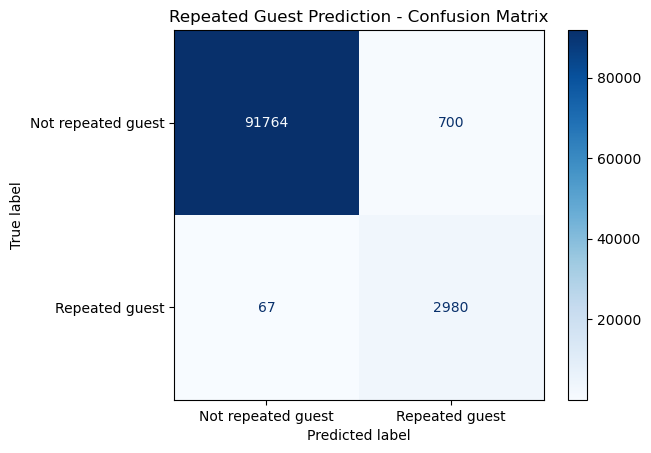

                    precision    recall  f1-score   support

Not repeated guest       1.00      0.99      1.00     92464
    Repeated guest       0.81      0.98      0.89      3047

          accuracy                           0.99     95511
         macro avg       0.90      0.99      0.94     95511
      weighted avg       0.99      0.99      0.99     95511



In [35]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_train, y_pred_train_1,
    display_labels=["Not repeated guest", "Repeated guest"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Repeated Guest Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_train, y_pred_train_1, target_names=["Not repeated guest", "Repeated guest"]))

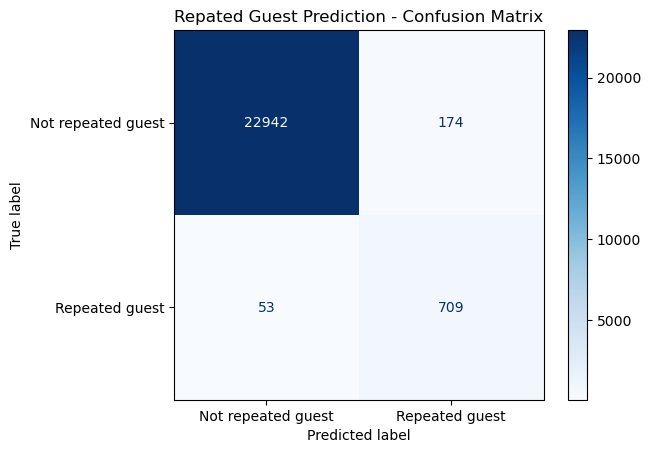

                    precision    recall  f1-score   support

Not repeated guest       1.00      0.99      1.00     23116
    Repeated guest       0.80      0.93      0.86       762

          accuracy                           0.99     23878
         macro avg       0.90      0.96      0.93     23878
      weighted avg       0.99      0.99      0.99     23878



In [36]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_test, y_pred_test_1,
    display_labels=["Not repeated guest", "Repeated guest"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Repated Guest Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_test, y_pred_test_1, target_names=["Not repeated guest", "Repeated guest"]))

ROC-AUC: 0.9936331041116833


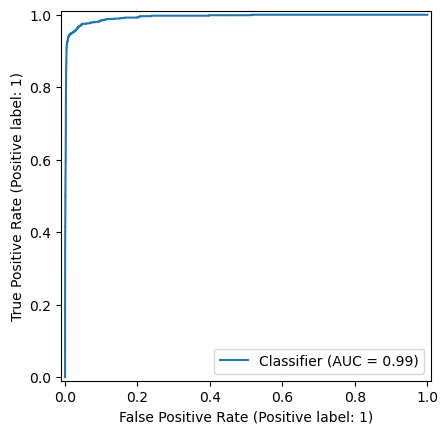

In [32]:
y_probs_1 = cat_boost_pipeline_1.predict_proba(X_test)[:,1]
auc_1 = roc_auc_score(y_test, y_probs_1)
print("ROC-AUC:", auc_1)

RocCurveDisplay.from_predictions(y_test, y_probs_1)
plt.show();

Best threshold: 0.8300000000000001
Best F1: 0.890330953926022


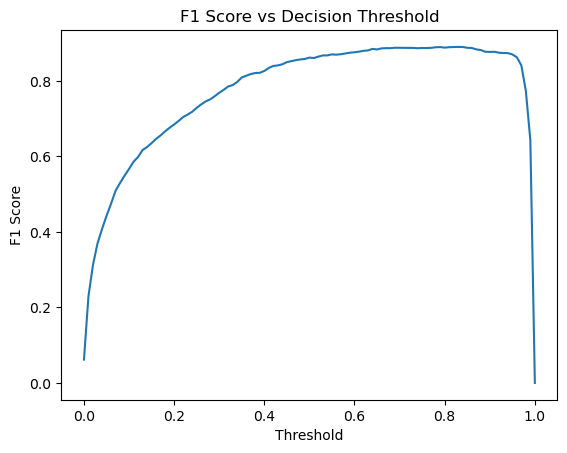

In [33]:
optimal_f1_search(y_test, y_probs_1)

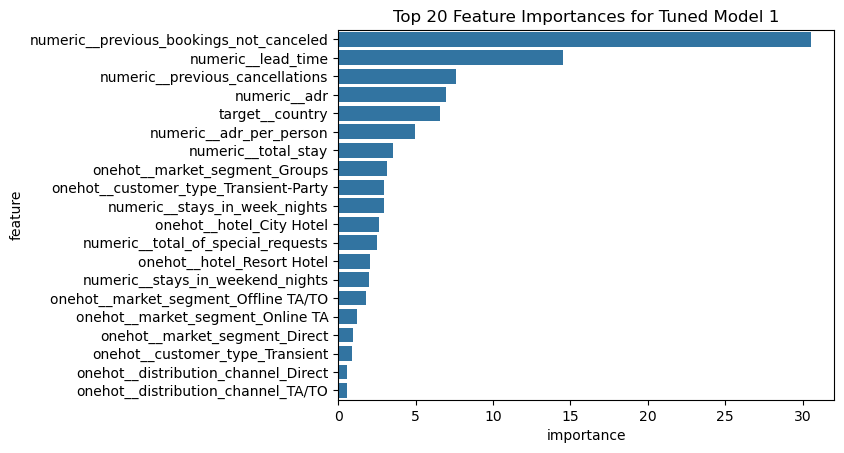

In [34]:
feature_names_1 = cat_boost_pipeline_1.named_steps["preprocessing"].get_feature_names_out()
tuned_cat_boost_model_1 = cat_boost_pipeline_1.named_steps['model']
importances_1 = tuned_cat_boost_model_1.feature_importances_

df_imp_1 = pd.DataFrame({
    'feature': feature_names_1,
    'importance': importances_1
}).sort_values(by='importance', ascending=False).head(20)

sns.barplot(x='importance', y='feature', data=df_imp_1)
plt.title("Top 20 Feature Importances for Tuned Model 1")
plt.show();

This model performs very well, but we will try to optimize it further. We can already notice that previous_bookings_not_canceled is a strong predictor, and almost acts like a proxy for repeated guest likelihood.

## Second Model

### Pipeline

In [38]:
class_weights_2 = [1, 15]

# Same as pipeline_1 but rewritten for clarity
pipeline_2 = Pipeline([
    # preprocessing step
    ("preprocessing", preprocessor),

    # model step
    ("model", CatBoostClassifier(
        # Basic hyperparameters
        iterations=2500,      # number of boosting rounds
        task_type='GPU',      # enable GPU
        devices='0',          # GPU device
        verbose=1,           # print progress every iteration
        early_stopping_rounds=100,  # stop if no improvement for 100 rounds
        random_state=42,
        class_weights=class_weights_2 # handling class imbalance
    ))
])

In [39]:
param_distributions_2 = {
    'model__depth': [5, 6, 7],
    'model__learning_rate': [0.001, 0.05, 0.01, 0.02],
    'model__l2_leaf_reg': [6, 7, 8],
    'model__bagging_temperature': [0], # will stick to 0 based on previous results
    'model__border_count': [32], # will stick to 32 based on previous results
    'model__min_data_in_leaf': [3, 4, 5, 6, 7],
    'model__colsample_bylevel': [1.0] # will stick to 1.0 based on previous results
}

### Randomized search setup

In [40]:
random_search_2 = RandomizedSearchCV(
    pipeline_2,
    param_distributions=param_distributions_2,
    n_iter=50,
    cv=3,
    scoring="roc_auc",
    verbose=3,
    n_jobs=1,
    random_state=42
)

### Search

In [41]:
random_search_2.fit(X_train, y_train)

cat_boost_pipeline_2 = random_search_2.best_estimator_
cat_boost_pipeline_2

Fitting 3 folds for each of 50 candidates, totalling 150 fits
0:	learn: 0.6583681	total: 3.75ms	remaining: 9.36s
1:	learn: 0.6255828	total: 7.21ms	remaining: 9s
2:	learn: 0.5950169	total: 10.4ms	remaining: 8.69s
3:	learn: 0.5665348	total: 14ms	remaining: 8.76s
4:	learn: 0.5394194	total: 17.4ms	remaining: 8.69s
5:	learn: 0.5140772	total: 21ms	remaining: 8.72s
6:	learn: 0.4908337	total: 24.3ms	remaining: 8.66s
7:	learn: 0.4692015	total: 28.4ms	remaining: 8.86s
8:	learn: 0.4486724	total: 32.3ms	remaining: 8.93s
9:	learn: 0.4284796	total: 35.7ms	remaining: 8.88s
10:	learn: 0.4094879	total: 39.1ms	remaining: 8.86s
11:	learn: 0.3944431	total: 42.6ms	remaining: 8.84s
12:	learn: 0.3778159	total: 46.1ms	remaining: 8.83s
13:	learn: 0.3655797	total: 49.7ms	remaining: 8.83s
14:	learn: 0.3515435	total: 53.1ms	remaining: 8.8s
15:	learn: 0.3407505	total: 56.6ms	remaining: 8.78s
16:	learn: 0.3285193	total: 59.9ms	remaining: 8.75s
17:	learn: 0.3163477	total: 63.4ms	remaining: 8.75s
18:	learn: 0.3056802

,steps,"[('preprocessing', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


In [42]:
random_search_2.best_params_

{'model__min_data_in_leaf': 4,
 'model__learning_rate': 0.01,
 'model__l2_leaf_reg': 8,
 'model__depth': 5,
 'model__colsample_bylevel': 1.0,
 'model__border_count': 32,
 'model__bagging_temperature': 0}

In [43]:
y_pred_train_2 = cat_boost_pipeline_2.predict(X_train)
y_pred_test_2 = cat_boost_pipeline_2.predict(X_test)

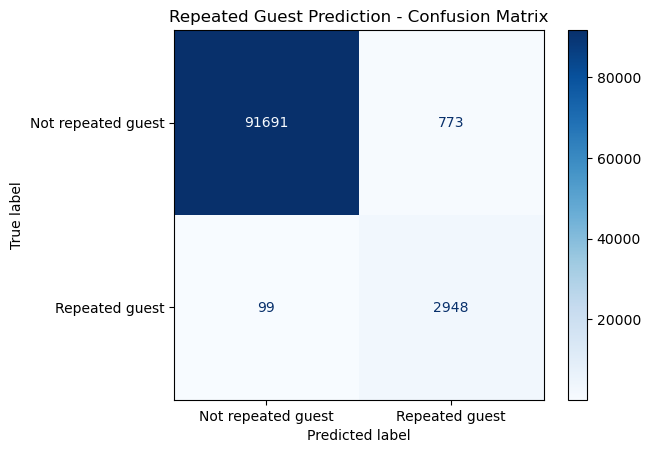

                    precision    recall  f1-score   support

Not repeated guest       1.00      0.99      1.00     92464
    Repeated guest       0.79      0.97      0.87      3047

          accuracy                           0.99     95511
         macro avg       0.90      0.98      0.93     95511
      weighted avg       0.99      0.99      0.99     95511



In [44]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_train, y_pred_train_2,
    display_labels=["Not repeated guest", "Repeated guest"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Repeated Guest Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_train, y_pred_train_2, target_names=["Not repeated guest", "Repeated guest"]))

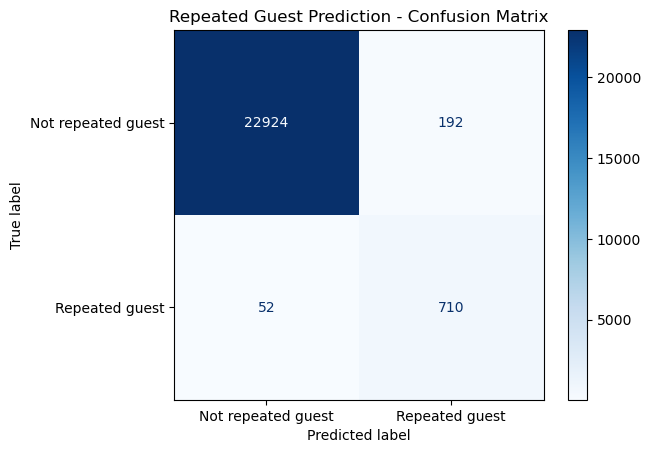

                    precision    recall  f1-score   support

Not repeated guest       1.00      0.99      0.99     23116
    Repeated guest       0.79      0.93      0.85       762

          accuracy                           0.99     23878
         macro avg       0.89      0.96      0.92     23878
      weighted avg       0.99      0.99      0.99     23878



In [45]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_test, y_pred_test_2,
    display_labels=["Not repeated guest", "Repeated guest"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Repeated Guest Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_test, y_pred_test_2, target_names=["Not repeated guest", "Repeated guest"]))

ROC-AUC: 0.9944339549159573


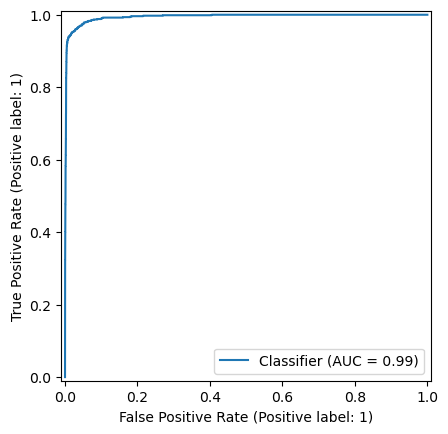

In [46]:
y_probs_2 = cat_boost_pipeline_2.predict_proba(X_test)[:,1]
auc_2 = roc_auc_score(y_test, y_probs_2)
print("ROC-AUC:", auc_2)

RocCurveDisplay.from_predictions(y_test, y_probs_2)
plt.show();

Best threshold: 0.76
Best F1: 0.8869009584664537


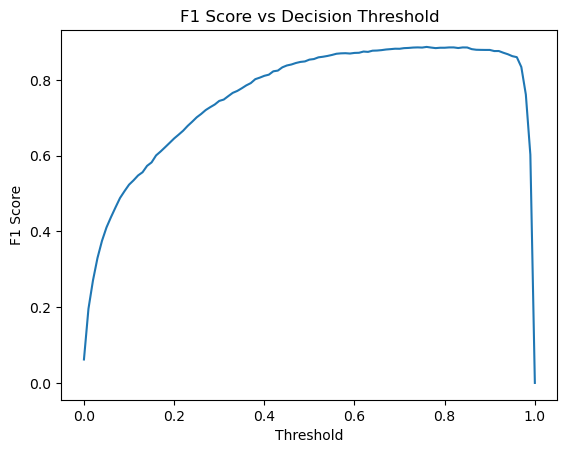

In [47]:
optimal_f1_search(y_test, y_probs_2)

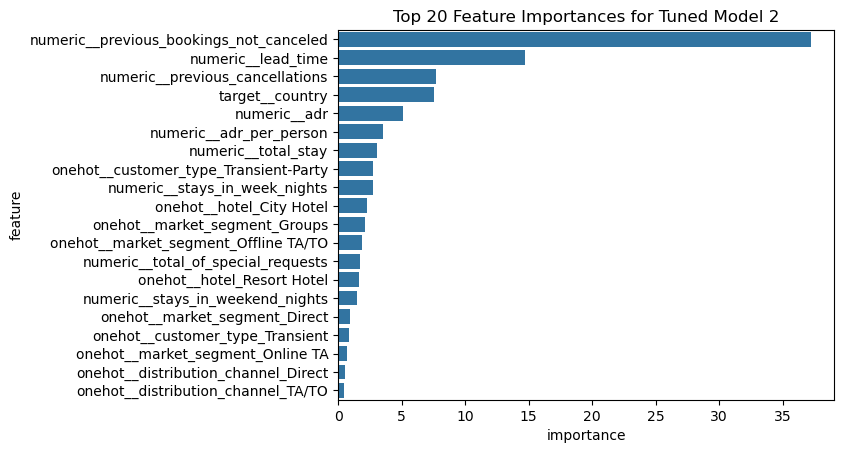

In [48]:
feature_names_2 = cat_boost_pipeline_2.named_steps["preprocessing"].get_feature_names_out()
tuned_cat_boost_model_2 = cat_boost_pipeline_2.named_steps['model']
importances_2 = tuned_cat_boost_model_2.feature_importances_

df_imp_2 = pd.DataFrame({
    'feature': feature_names_2,
    'importance': importances_2
}).sort_values(by='importance', ascending=False).head(20)

sns.barplot(x='importance', y='feature', data=df_imp_2)
plt.title("Top 20 Feature Importances for Tuned Model 2")
plt.show();

## Saving the best model, f1 threshold, feature importancesm and mean shap values

### Save model

In [8]:
# Custom transformer for engineered features
class FeatureEngineerRepeatedGuest(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    
    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X = X.copy()
        # total_stay
        X['total_stay'] = X['stays_in_weekend_nights'] + X['stays_in_week_nights']
        # adr_per_person
        X['adr_per_person'] = X['adr'] / (X['adults'] + X['children'] + X['babies']).replace(0, 1)
        return X
    
    created_columns = ['total_stay', 'adr_per_person']

In [9]:
ALL_REQUIRED_COLUMNS = onehot_cols + target_cols + numeric_cols + ['adults', 'children', 'babies']

ALL_REQUIRED_COLUMNS = [c for c in ALL_REQUIRED_COLUMNS if c not in FeatureEngineerRepeatedGuest.created_columns]

In [10]:
best_params = {'model__min_data_in_leaf': 4,
 'model__learning_rate': 0.01,
 'model__l2_leaf_reg': 8,
 'model__depth': 5,
 'model__colsample_bylevel': 1.0,
 'model__border_count': 32,
 'model__bagging_temperature': 0}

In [11]:
class SchemaValidator(BaseEstimator, TransformerMixin):
    def __init__(self, required_columns):
        self.required_columns = required_columns

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        missing = [c for c in self.required_columns if c not in X.columns]
        if missing:
            raise ValueError(
                f"Model input schema violation. Missing columns: {missing}"
            )
        return X

In [14]:
pipeline_final = Pipeline([
    ("schema_validator", SchemaValidator(ALL_REQUIRED_COLUMNS)),
    ("feature_engineering", FeatureEngineerRepeatedGuest()),
    ("preprocessing", preprocessor),
    ("model", CatBoostClassifier(
        iterations=2500,
        task_type='CPU', # use CPU for final model
        # devices='0', # not needed for CPU
        verbose=1,
        early_stopping_rounds=100,
        random_state=42,
        class_weights=class_weights_2,
        **{key.replace('model__', ''): value for key, value in best_params.items() if key.startswith('model__')}
    ))
])

In [15]:
pipeline_final.fit(X_train, y_train)

0:	learn: 0.6757687	total: 145ms	remaining: 6m 3s
1:	learn: 0.6612683	total: 151ms	remaining: 3m 9s
2:	learn: 0.6448590	total: 157ms	remaining: 2m 10s
3:	learn: 0.6280672	total: 163ms	remaining: 1m 41s
4:	learn: 0.6129372	total: 169ms	remaining: 1m 24s
5:	learn: 0.5977930	total: 174ms	remaining: 1m 12s
6:	learn: 0.5854669	total: 180ms	remaining: 1m 4s
7:	learn: 0.5738878	total: 185ms	remaining: 57.7s
8:	learn: 0.5595763	total: 191ms	remaining: 52.8s
9:	learn: 0.5481884	total: 196ms	remaining: 48.9s
10:	learn: 0.5373735	total: 202ms	remaining: 45.7s
11:	learn: 0.5266906	total: 207ms	remaining: 42.9s
12:	learn: 0.5147473	total: 212ms	remaining: 40.6s
13:	learn: 0.5034759	total: 217ms	remaining: 38.5s
14:	learn: 0.4921877	total: 222ms	remaining: 36.8s
15:	learn: 0.4812839	total: 227ms	remaining: 35.3s
16:	learn: 0.4725338	total: 233ms	remaining: 34s
17:	learn: 0.4626880	total: 238ms	remaining: 32.8s
18:	learn: 0.4527484	total: 243ms	remaining: 31.7s
19:	learn: 0.4439582	total: 248ms	remai

,steps,"[('schema_validator', ...), ('feature_engineering', ...), ...]"
,transform_input,None
,memory,None
,verbose,False
,required_columns,"['hotel', 'market_segment', ...]"
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False


In [16]:
joblib.dump(pipeline_final, "../../models/catboost_repeated_guest_model_final.joblib")

['../../models/catboost_repeated_guest_model_final.joblib']

### Save feature importances

In [79]:
df_imp_2.to_csv("../../models/catboost_repeated_guest_model_final_feature_importances.csv", index=False)

### Save shap values

In [80]:
X_sample = X_test.copy()
X_sample.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card,total_stay,adr_per_person
39379,Resort Hotel,0,160,2017,August,32,7,3,7,2,...,0,2,Check-Out,2017-08-17,Alyssa Walker,AlyssaWalker70@aol.com,594-282-5910,************1740,10,76.75
20647,Resort Hotel,0,2,2016,February,6,5,0,1,2,...,0,0,Check-Out,2016-02-06,Jonathan Johnson,Jonathan_Johnson@hotmail.com,117-806-6570,************4920,1,29.00
97750,City Hotel,0,23,2017,May,21,25,0,3,1,...,0,2,Check-Out,2017-05-28,Lee Miller,Lee.M@outlook.com,350-468-3508,************5229,3,0.00
30528,Resort Hotel,0,30,2016,November,48,24,0,2,3,...,0,1,Check-Out,2016-11-26,Aaron Young,AYoung48@outlook.com,147-461-8444,************6787,2,23.25
74686,City Hotel,1,365,2015,October,42,17,1,1,2,...,0,0,Canceled,2015-01-30,Sandra Lucas,SLucas@yandex.com,335-611-1398,************4139,2,31.40


In [81]:
X_transformed = pipeline_final[:-1].transform(X_sample)

In [82]:
catboost_model = pipeline_final.named_steps['model']

explainer = shap.TreeExplainer(catboost_model)

shap_values = explainer(X_transformed)

In [83]:
onehot_feature_names = pipeline_final.named_steps['preprocessing'].named_transformers_['onehot'].get_feature_names_out()
feature_names = np.concatenate([target_cols, onehot_feature_names, numeric_cols])

print(feature_names.shape)

(29,)


In [84]:
shap_df = pd.DataFrame(shap_values.values, columns=feature_names)
shap_df

,country,hotel_City Hotel,hotel_Resort Hotel,market_segment_Aviation,market_segment_Complementary,market_segment_Corporate,market_segment_Direct,market_segment_Groups,market_segment_Offline TA/TO,market_segment_Online TA,...,customer_type_Transient-Party,lead_time,stays_in_weekend_nights,stays_in_week_nights,previous_cancellations,previous_bookings_not_canceled,total_of_special_requests,adr,adr_per_person,total_stay
0,0.052412,0.509665,0.513511,-0.001169,0.000603,0.009651,-0.084309,0.146968,-0.634917,0.236047,...,0.127167,-1.069658,-0.174886,0.359738,-0.395326,-1.426449,0.666484,-0.647475,0.138331,0.584748
1,-1.025867,0.145093,0.126979,-0.002068,0.000495,0.001433,-0.091560,0.112881,0.042708,-0.125186,...,0.033172,0.823748,0.133943,-0.150411,-0.400923,-2.025804,-0.226298,0.431170,0.105128,-0.073499
2,0.626902,-0.020079,-0.027589,-0.004012,-0.061915,-0.008374,0.076640,0.135909,-0.070864,0.033992,...,0.038405,0.383779,0.184719,0.033834,-0.292491,5.924580,0.243047,0.347981,0.208038,-0.021615
3,0.821173,0.279851,0.283396,-0.000772,0.001258,0.005644,-0.072791,0.123614,0.058244,-0.154506,...,-0.087897,-0.610698,0.156151,-0.095015,-0.390729,-1.667390,0.199013,-0.057037,0.145669,0.033235
4,0.729123,-0.080156,-0.061360,-0.000824,-0.001386,0.001661,-0.049911,-0.940379,0.061753,0.006916,...,-0.336492,-2.373093,-0.252102,-0.292121,3.669084,-1.567911,-0.080643,0.963116,0.320559,0.086885
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23873,-0.176739,0.205981,0.179168,-0.001094,0.001268,0.000593,0.834439,0.103437,0.045466,0.110540,...,0.040017,1.343213,0.134009,-0.156731,-0.393277,-1.990893,-0.301563,0.385014,-0.081070,-0.133173
23874,0.826566,-0.177031,-0.150674,-0.000809,0.000839,0.003144,-0.063717,0.137379,-0.307840,0.142328,...,0.034663,-1.850225,0.153102,-0.228872,-0.496030,-1.715341,-0.115636,0.494246,0.041189,-0.161263
23875,-0.458309,0.346895,0.368380,-0.000997,0.001195,0.008960,0.820221,0.124040,0.055540,0.113897,...,-0.042692,-1.085516,0.117760,-0.106552,-0.345985,-1.590475,0.328157,0.372091,0.176916,-0.002645
23876,-1.535132,-0.210137,-0.197493,-0.001650,0.000452,-0.006547,-0.058052,0.144192,0.063333,-0.178927,...,0.008900,-1.450267,-0.068811,0.148340,-0.467218,-1.631052,-0.130897,-0.272232,-0.179133,0.034539


In [85]:
shap_abs_mean = np.abs(shap_values.values).mean(axis=0)
shap_df_global = pd.DataFrame({
    'feature': feature_names,
    'mean_abs_shap': shap_abs_mean
}).sort_values(by='mean_abs_shap', ascending=False)

shap_df_global

,feature,mean_abs_shap
24,previous_bookings_not_canceled,1.791697e+00
20,lead_time,1.299333e+00
0,country,8.157684e-01
23,previous_cancellations,5.754909e-01
26,adr,3.592409e-01
7,market_segment_Groups,2.397760e-01
1,hotel_City Hotel,2.212713e-01
2,hotel_Resort Hotel,2.136473e-01
25,total_of_special_requests,1.892457e-01
21,stays_in_weekend_nights,1.791658e-01


In [86]:
shap_df_global.to_csv("../../models/catboost_repeated_guest_model_final_shap_importances.csv", index=False)

## END OF FILE